$\Large\color{blue}{\text{PyGMTSAR Yamchi Dam Sentinel-1 SLC Timeseries Analysis}}$

$\Large\color{blue}{\text{Scenes on Alaska Satellite Facility (ASF) for POINT(48.0768 38.3)}}$

See
http://mgviz.ucsd.edu/?mission=ESESES

https://github.com/gmtsar/2022-unavco-course-gmtsar/blob/main/Jupyter/gmtsar_correcting_intf_with_gps_example.ipynb

http://geodesy.unr.edu/NGLStationPages/gpsnetmap/GPSNetMap.html

https://topex.ucsd.edu/gmtsar/tar/sentinel_time_series_4.pdf

https://search.asf.alaska.edu/

### See and more PyGMTSAR notebooks on GitHub: [PyGMTSAR](https://github.com/mobigroup/gmtsar)

It works on

* MacOS Monterey (Apple Silicon) and BigSur (Intel) (Python 3.9) - please pre-install system dependencies (maybe using HomeBrew),

* Google Cloud VM and Notebooks on Debian 10 (Python 3.7), use the [Google Cloud Debian 10 init script](https://github.com/mobigroup/gmtsar/blob/master/gmtsar/sh/GMTSAR.install.debian10.sh) and [Google Cloud Debian 10 VM creation script](https://github.com/mobigroup/gmtsar/blob/master/gmtsar/sh/GMTSAR.gcloud_create_debian10.sh)

* $\color{red}{\text{Google Colab (Python 3.7) - you will be asked to re-run the notebook once due to "system crash" by desing}}$
$\color{red}{\text{Note: to open all notebook cells select menu "View" -> "Expand Sections"}}$

### PyGMTSAR is my free-time Open Source project.

That's a bit curious how the project was started a year ago. I develop geophysical inversion methods and processing software for many years using my fundamental physics and mathematics background. Satellite interferometry is the key point to validate my inversion models and I found the same problem as you too that the existing interferometry packages usage is a pain. There is no interactive processing with multiprocessing and even a progressbar and ability to view and change every step code and validate the results. Also, many used algorithms are too outdated and produce terrible results like to tension surfaces in GMT which is used widely in GMTSAR (hmm, how about to control a smothness of derivative? Tension surfaces were invented when all the Earths computers where less powerfull than your smarthone today. If you are interested I shared the examples in GMTSAR bug tracker). Anyway, I found GMT mathematics is really crazy and the developers replace one incorrect algorithm by another and back often as we see in the codes and the changelog). That was enough reason to check all the used algorithms and replace these by modern and correct ones. By this way, I use only GMTSAR C codes with my patches to fix some errors and allow interoperability with Python wrappers plus my own codes around them. GMTSAR codes are fine and without crazy GMT codes work better and the processing is much faster. Alright, I spent one month to make the initial PyGMTSAR realization and it works. Recently, I returned to the project to add some more sophisticated features like to scenes and subswathes stitching. I'm going to share some of my geological exprorations and seismic models as live examples on Google Colab as soon as it will be possible to do. How lineaments and ore zones are related to interferograms? How gas and oil deposits are related to surface movements on interferometry displacement maps? I have the answer and I work on the tools to model and visualize them.

You'd find my theoretical models and processing codes foir geophisical inversions in Github repository https://github.com/mobigroup/gis-snippets and tools for the 4D results vizualization in https://github.com/mobigroup/ParaView-plugins

Ah yes, a little bit about me. I have STEM master's degree in radio physics and in 2004 I was awarded first prize of the All-Russian Physics competition for significant results in Inverse modeling for non-linear optics and holography, also applicable for Inverse Modeling of Gravity, Magnetic, and Thermal fields. In addition to my fundamental science knowledge, I’m world class data scientist and software developer with 20 years experience in science and industrial development. I have worked on government contracts and universities projects and on projects for LG Corp, Google Inc, etc. You are able to find some of my software and results on LinkedIn and GitHub and Upwork. By the way, I left Russia many years ago and I work remotely for about 20 years.

### To order some research, development and support see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623)

### @ Alexey Pechnikov, August, 2022

[Geological models on YouTube channel](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg)

[Augmented Reality (AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/)

[GitHub repositories](https://github.com/mobigroup)

[English posts and articles on LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/)

[Russian articles on Habr](https://habr.com/ru/users/N-Cube/posts/)

## Load Modules to Check Environment

In [1]:
import platform, sys, os

## Load and Setup Python Modules

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
# plotting modules
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa
import holoviews as hv
pd.options.plotting.backend = 'hvplot'
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [4]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

## Load Custom Python Modules

In [5]:
# default chunksize (512) is enough suitable for a single subswath processing using resolution 15m
# select higher chunk size (1024) to process multiple subswaths and scenes using resolution 15m
from pygmtsar import datagrid
datagrid.chunksize = 1024
# import the top level class only
from pygmtsar import SBAS

## Define 3 Sentinel-1 Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

### Descending Orbit Configuration

In [6]:
ORBIT        = 'D'

### Ascending Orbit Configuration

## Common Configuration

In [7]:
BACKUP       = 'backup_asc' if ORBIT == 'A' else 'backup_desc'
WORKDIR      = 'raw_asc' if ORBIT == 'A' else 'raw_desc'
DEMFILE      = None
POLARIZATION = 'VV'
# SBAS parameters
BASEDAYS     = 65
BASEMETERS   = 150

In [8]:
# also, that's possible to unwrap without the threshold
CORRSTACKLIMIT = 0.15

## Run Local Dask Cluster

Launch Dask cluster for big data processing. Use "Dashboard" link below for the local cluster state and execution monitoring.

In [52]:
import dask, dask.distributed
# increase timeouts to work using default chunk size (512) even on large areas
dask.config.set({'distributed.comm.timeouts.tcp': '60s'})
#print (dask.config.get("distributed.comm.timeouts.tcp"))
dask.config.set({'distributed.comm.timeouts.connect': '60s'})
#print (dask.config.get("distributed.comm.timeouts.connect"))

from dask.distributed import Client, LocalCluster
cluster = LocalCluster(n_workers=2)
client = Client(cluster)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:51167/status,
Dashboard: http://127.0.0.1:51167/status,Workers: 2
Total threads: 8,Total memory: 16.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:51168,Workers: 2
Dashboard: http://127.0.0.1:51167/status,Total threads: 8
Started: Just now,Total memory: 16.00 GiB
Comm: tcp://127.0.0.1:51178,Total threads: 4
Dashboard: http://127.0.0.1:51179/status,Memory: 8.00 GiB
Nanny: tcp://127.0.0.1:51172,


## Restore SBAS

In [10]:
sbas = SBAS.restore(WORKDIR)

NOTE: load state from file raw_desc/SBAS.pickle


In [11]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-01-09,2022-01-09 02:52:55,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220109t025257-20220109t025347-041378-04eb6a-004.tiff, raw_desc/s1a-iw2-slc-vv-20220109t025255-20220109t025348-041378-04eb6a-005.tiff, raw_desc/s1a-iw3-slc-vv-20220109t025256-20220109t025346-041378-04eb6a-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220109t025257-20220109t025347-041378-04eb6a-004.xml, raw_desc/s1a-iw2-slc-vv-20220109t025255-20220109t025348-041378-04eb6a-005.xml, raw_desc/s1a-iw3-slc-vv-20220109t025256-20220109t025346-041378-04eb6a-006.xml]",/Volumes/DISK/work/Yamchi/data/desc/2022/S1A_OPER_AUX_POEORB_OPOD_20220129T121556_V20220108T225942_20220110T005942.EOF,"POLYGON ((49.55044 39.58529, 48.78057 36.48907, 47.86206 36.71745, 47.82616 36.56834, 46.77516 36.82134, 46.78519 36.86300, 45.97606 37.03604, 46.63464 40.11560, 47.52247 39.92574, 47.56120 40.08664, 48.61221 39.83363, 48.60879 39.81943, 49.55044 39.58529))"
2022-01-21,2022-01-21 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220121t025256-20220121t025346-041553-04f124-004.tiff, raw_desc/s1a-iw2-slc-vv-20220121t025254-20220121t025347-041553-04f124-005.tiff, raw_desc/s1a-iw3-slc-vv-20220121t025255-20220121t025345-041553-04f124-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220121t025256-20220121t025346-041553-04f124-004.xml, raw_desc/s1a-iw2-slc-vv-20220121t025254-20220121t025347-041553-04f124-005.xml, raw_desc/s1a-iw3-slc-vv-20220121t025255-20220121t025345-041553-04f124-006.xml]",/Volumes/DISK/work/Yamchi/data/desc/2022/S1A_OPER_AUX_POEORB_OPOD_20220210T081610_V20220120T225942_20220122T005942.EOF,"POLYGON ((49.55021 39.58586, 48.78045 36.48963, 47.86190 36.71799, 47.82607 36.56913, 46.77504 36.82210, 46.78504 36.86366, 45.97598 37.03664, 46.63443 40.11620, 47.52221 39.92638, 47.56087 40.08703, 48.61191 39.83406, 48.60852 39.81997, 49.55021 39.58586))"
2022-02-02,2022-02-02 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.tiff, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.tiff, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220202t025256-20220202t025346-041728-04f723-004.xml, raw_desc/s1a-iw2-slc-vv-20220202t025254-20220202t025346-041728-04f723-005.xml, raw_desc/s1a-iw3-slc-vv-20220202t025255-20220202t025345-041728-04f723-006.xml]",/Volumes/DISK/work/Yamchi/data/desc/2022/S1A_OPER_AUX_POEORB_OPOD_20220222T081603_V20220201T225942_20220203T005942.EOF,"POLYGON ((49.54992 39.58491, 48.78032 36.48917, 47.86182 36.71751, 47.82594 36.56841, 46.77495 36.82136, 46.78495 36.86293, 45.97585 37.03591, 46.63417 40.11510, 47.52200 39.92529, 47.56072 40.08617, 48.61171 39.83322, 48.60829 39.81900, 49.54992 39.58491))"
2022-02-14,2022-02-14 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.tiff, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.tiff, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.tiff]","[raw_desc/s1a-iw1-slc-vv-20220214t025256-20220214t025346-041903-04fd3e-004.xml, raw_desc/s1a-iw2-slc-vv-20220214t025254-20220214t025347-041903-04fd3e-005.xml, raw_desc/s1a-iw3-slc-vv-20220214t025255-20220214t025345-041903-04fd3e-006.xml]",/Volumes/DISK/work/Yamchi/data/desc/2022/S1A_OPER_AUX_POEORB_OPOD_20220306T081614_V20220213T225942_20220215T005942.EOF,"POLYGON ((49.54920 39.58515, 48.77939 36.48867, 47.86097 36.71699, 47.82509 36.56790, 46.77415 36.82084, 46.78415 36.86241, 45.97506 37.03540, 46.63355 40.11510, 47.52134 39.92528, 47.56006 40.08615, 48.61100 39.83321, 48.60763 39.81923, 49.54920 39.58515))"
2022-02-26,2022-02-26 02:52:54,D,S1A,VV,123,"[raw_desc/s1a-iw1-slc-vv-20220226t025256-20220226t025345-042078-050346-004.tiff, raw_desc/s1a-iw2-slc-vv-20220226t025254-20220226t025346-042078-050346-005.tiff, raw_desc/s1a-iw3-slc-vv-20220226t025255-20220226t025345-042078-050346-006

## Find SBAS Pairs

Scan work directory to find all the processed pairs

In [12]:
pairs = sbas.find_pairs('corr')
#pairs

## Build decimator for plots

Large grid plots require a lot of RAM so decimate plots to build smaller images visually almost the same as the original ones.

In [13]:
# decimate arrays to plot
decimator = sbas.pixel_decimator(resolution_meters=300, debug=True)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=14.6
DEBUG: decimator = lambda da: da.coarsen({'y': 21, 'x': 21}, boundary='trim').mean()


## Build Correlation Mask

Use stacked correlation mean value threshold

In [14]:
corrs = sbas.open_grids(pairs, 'corr')
corrs

Loading:   0%|          | 0/63 [00:00<?, ?it/s]

<xarray.DataArray 'z' (pair: 63, y: 25617, x: 17029)>
dask.array<concatenate, shape=(63, 25617, 17029), dtype=float32, chunksize=(1, 1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.562e+04 2.562e+04
  * pair     (pair) <U17 '20220109 20220121' ... '20220708 20220720'
    ref      (pair) <U8 '20220109' '20220109' ... '20220626' '20220708'
    rep      (pair) <U8 '20220121' '20220202' ... '20220720' '20220720'
Attributes:
    long_name:     z
    actual_range:  [0.00243752 0.99694502]

In [15]:
%%time

# calculate correlation stack on lazy dask arrays
# use .compute() to materialize the result for repeated usage 
corr_stack = corrs.mean('pair').compute()

CPU times: user 56.9 s, sys: 8.51 s, total: 1min 5s
Wall time: 5min 52s


In [16]:
# create binary mask
corr_mask = xr.where(corr_stack >= CORRSTACKLIMIT,1,0).astype(bool)

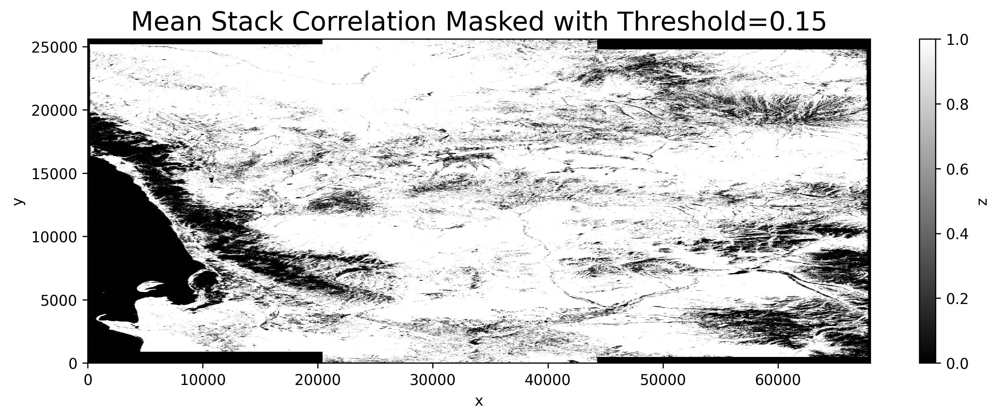

In [17]:
plt.figure(figsize=(12,4), dpi=300)
decimator(corr_mask).plot.imshow(vmin=0, vmax=1, cmap='gray')
plt.title(f'Mean Stack Correlation Masked with Threshold={CORRSTACKLIMIT}', fontsize=18)
plt.show()

## Define landmask

In [18]:
sbas.download_landmask()

Landmask Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
# materialize the grid to reused it multiple times below
landmask = sbas.get_landmask(inverse_geocode=True).astype(bool).compute()

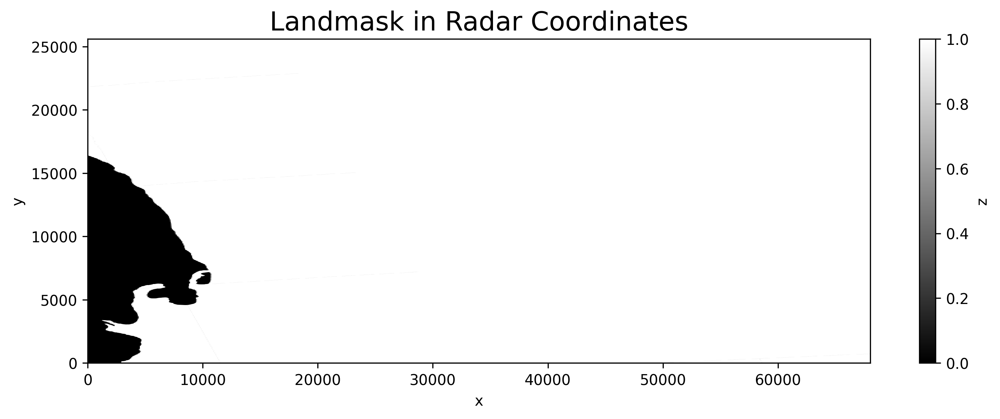

In [20]:
plt.figure(figsize=(12,4), dpi=300)
decimator(landmask).plot.imshow(cmap='gray')
plt.title('Landmask in Radar Coordinates', fontsize=18)
plt.show()

## Define Composite Mask

In [21]:
# merge binary masks
#composite_mask = corr_mask & user_mask
composite_mask = corr_mask & landmask

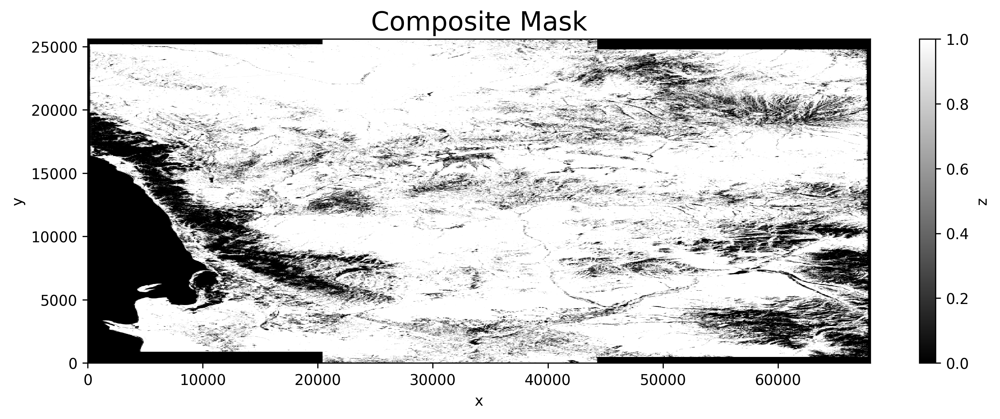

In [22]:
plt.figure(figsize=(12,4), dpi=300)
decimator(composite_mask).plot.imshow(cmap='gray')
plt.title('Composite Mask', fontsize=18)
plt.show()

## Unwrapping

Attention: in case of crash on MacOS Apple Silicon run Jupyter as

`OBJC_DISABLE_INITIALIZE_FORK_SAFETY=YES no_proxy='*' jupyter notebook`

In [23]:
# define a post-processing function to crop low-coherence areas
cleaner = lambda corr, unwrap: xr.where(corr>0, unwrap, np.nan)

# define a post-processing function to crop and interpolate low-coherence areas
#cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

In [24]:
# tiled SNAPHU config is helpful to unwrap large areas
# use NPROC parameter to define number of cores for the processing, by default all the cores used
#snaphu Exceeded maximum number of secondary arcs
#Decrease TILECOSTTHRESH and/or increase MINREGIONSIZE
#TILECOSTTHRESH=250, MINREGIONSIZE=200, 
conf = sbas.PRM().snaphu_config(NTILEROW=16, NTILECOL=16, ROWOVRLP=200, COLOVRLP=200, SINGLETILEREOPTIMIZE=False)

In [25]:
# check the generated SNAPHU config and tune the SNAPHU parameters above if needed.
print ('SNAPHU custom config generated:')
print (conf)

SNAPHU custom config generated:

    # basic config
    INFILEFORMAT   FLOAT_DATA
    OUTFILEFORMAT  FLOAT_DATA
    AMPFILEFORMAT  FLOAT_DATA
    CORRFILEFORMAT FLOAT_DATA
    ALTITUDE       693000.0
    EARTHRADIUS    6378000.0
    NEARRANGE      831000
    DR             18.4
    DA             28.2
    RANGERES       28
    AZRES          44
    LAMBDA         0.0554658
    NLOOKSRANGE    1
    NLOOKSAZ       1
    DEFOMAX_CYCLE  0
    TILEDIR        raw_desc/S1_20220226_ALL_F123_snaphu_tiledir
    NPROC          8
    # custom config
    NTILEROW 16
    NTILECOL 16
    ROWOVRLP 200
    COLOVRLP 200
    SINGLETILEREOPTIMIZE FALSE



### Unwrap test

In [26]:
phase = sbas.open_grids(pairs[:1], 'phasefilt')[0]
phase

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.DataArray 'z' (y: 25617, x: 17029)>
dask.array<getitem, shape=(25617, 17029), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.562e+04 2.562e+04
    pair     <U17 '20220109 20220121'
    ref      <U8 '20220109'
    rep      <U8 '20220121'
Attributes:
    long_name:     z
    actual_range:  [-3.1415925  3.1415925]

In [27]:
corr = sbas.open_grids(pairs[:1], 'corr')[0]
corr

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.DataArray 'z' (y: 25617, x: 17029)>
dask.array<getitem, shape=(25617, 17029), dtype=float32, chunksize=(1024, 1024), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 2.0 6.0 10.0 14.0 ... 6.811e+04 6.811e+04 6.811e+04
  * y        (y) float64 0.5 1.5 2.5 3.5 ... 2.561e+04 2.562e+04 2.562e+04
    pair     <U17 '20220109 20220121'
    ref      <U8 '20220109'
    rep      <U8 '20220121'
Attributes:
    long_name:     z
    actual_range:  [0.00243752 0.99694502]

### Use composite mask only

In [28]:
%%time

unwrap, conn = sbas.unwrap(pairs[0], mask=composite_mask, conf=conf, conncomp=True)

CPU times: user 57.6 s, sys: 23.7 s, total: 1min 21s
Wall time: 24min 49s


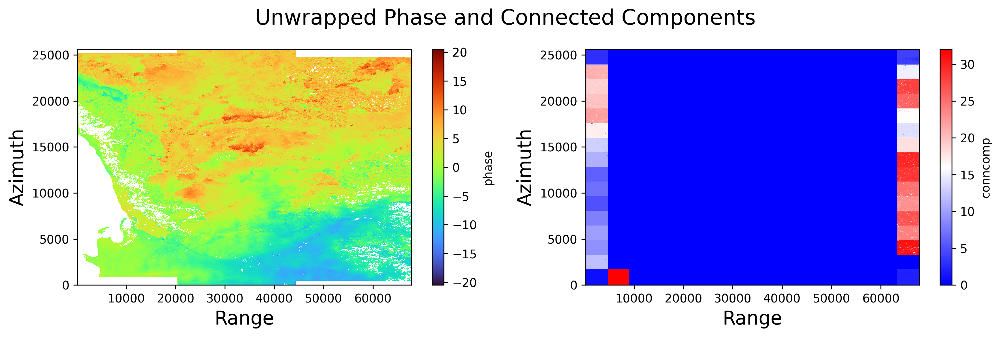

In [29]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

### Use landmask and correlation threshold

In [30]:
%%time

unwrap, conn = sbas.unwrap(pairs[0], threshold=CORRSTACKLIMIT, mask=landmask, conf=conf, conncomp=True)

CPU times: user 1min 54s, sys: 40.1 s, total: 2min 34s
Wall time: 51min 49s


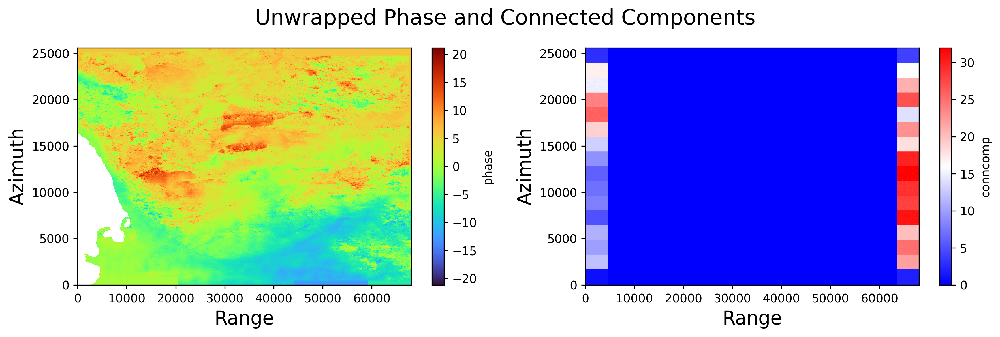

In [31]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

### Use composite mask and correlation threshold

In [32]:
%%time

unwrap, conn = sbas.unwrap(pairs[0], threshold=CORRSTACKLIMIT, mask=composite_mask, conf=conf, conncomp=True)

CPU times: user 57.7 s, sys: 23.4 s, total: 1min 21s
Wall time: 24min 43s


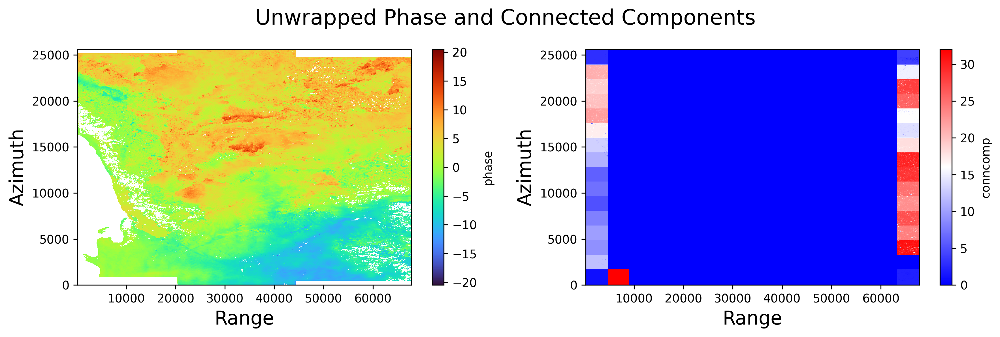

In [33]:
fig = plt.figure(figsize=(12,4), dpi=300)

ax = fig.add_subplot(1, 2, 1)
decimator(unwrap).plot.imshow(cmap='turbo', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

ax = fig.add_subplot(1, 2, 2)
decimator(conn).plot.imshow(cmap='bwr', ax=ax)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
#plt.title('Subswath', fontsize=18)

plt.suptitle('Unwrapped Phase and Connected Components', fontsize=18)
plt.tight_layout()
plt.show()

## Unwrap all

In [ ]:
# on 8 cores CPU use 4 job for 4-core multi-tile snaphu processing on large areas
# correlation threshold drops low coherence areas on this interferogram
# stack coherency mask drops low coherence areas in average
sbas.unwrap_parallel(mask=composite_mask, conf=conf, n_jobs=2)

## Load and Display Top 25 Unwrapped Phase

In [35]:
# decimate to plot faster
unwraps = decimator(sbas.open_grids(pairs[:25], 'unwrap'))

Loading:   0%|          | 0/25 [00:00<?, ?it/s]

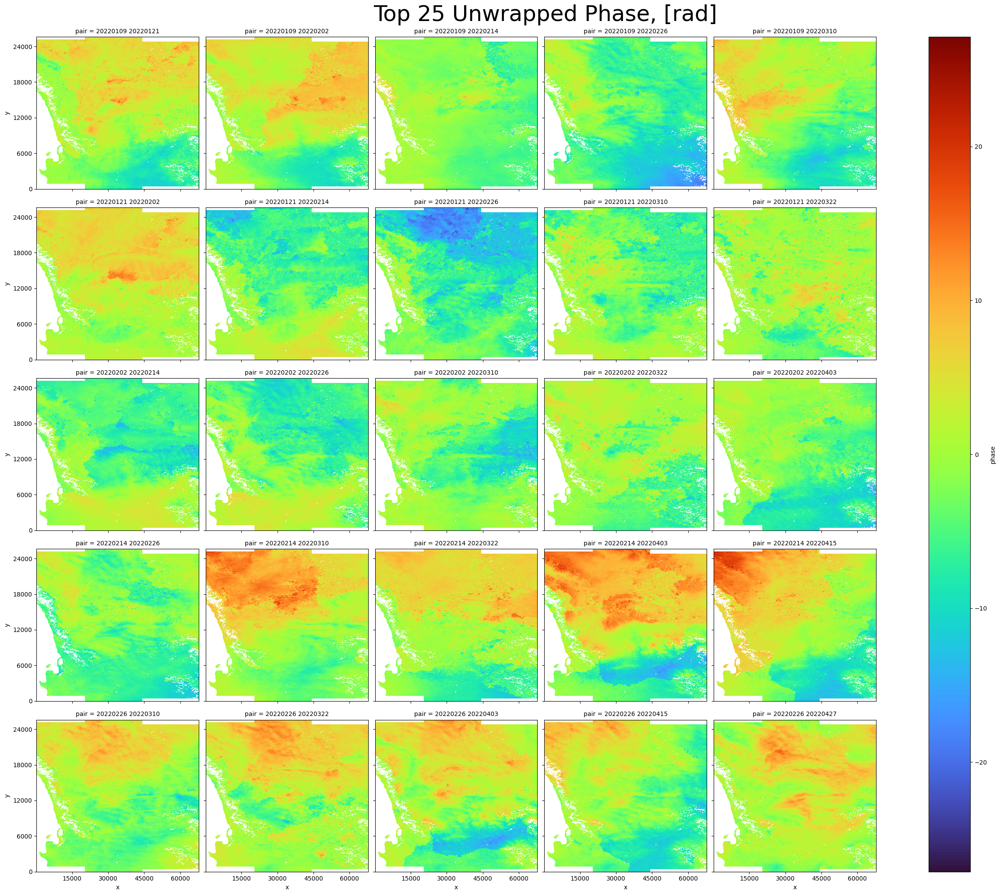

CPU times: user 45.3 s, sys: 6.22 s, total: 51.5 s
Wall time: 6min 20s


In [37]:
%%time

fg = unwraps.plot.imshow(
    col='pair',
    col_wrap=5, size=4, aspect=1.2,
    cmap='turbo'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Top 25 Unwrapped Phase, [rad]', y=1.02, fontsize=36)
#plt.savefig(f'Unwrapped Phase, [rad].jpg', dpi=150, quality=95)
plt.show()

## Check and Export Area in Geographic Coordinates

Low-coherence areas would be cropped on the next step (unwrapping).

In [56]:
client.restart()

2022-11-06 19:40:23,068 - distributed.nanny - WARNING - Restarting worker


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:51167/status,
Dashboard: http://127.0.0.1:51167/status,Workers: 1
Total threads: 4,Total memory: 8.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:51168,Workers: 1
Dashboard: http://127.0.0.1:51167/status,Total threads: 4
Started: 4 minutes ago,Total memory: 8.00 GiB
Comm: tcp://127.0.0.1:51532,Total threads: 4
Dashboard: http://127.0.0.1:51533/status,Memory: 8.00 GiB
Nanny: tcp://127.0.0.1:51171,


In [57]:
filename = f'{WORKDIR}.unwrapsample.nc'
# drop the existing file first
!rm -fr {filename}
# show progress indicator for the long operation
from pygmtsar import tqdm_dask
# load one grid (pairs[:1]) in geographic coordinates (geocode=True) and cropped to valid extent (crop_valid=True)
delayed = sbas.open_grids(pairs[:1], 'unwrap', geocode=True)[0]\
    .to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving Sample Unwrapped Grid as NetCDF')

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Saving Sample Unwrapped Grid as NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

2022-11-06 19:40:37,484 - distributed.comm.tcp - WARNING - Closing dangling stream in <TCP  local=tcp://127.0.0.1:51194 remote=tcp://127.0.0.1:51168>
Task was destroyed but it is pending!
task: <Task pending name='Task-3438811' coro=<ProgressBar.listen() running at /opt/homebrew/lib/python3.10/site-packages/distributed/diagnostics/progressbar.py:92> wait_for=<Future cancelled> cb=[IOLoop.add_future.<locals>.<lambda>() at /opt/homebrew/lib/python3.10/site-packages/tornado/ioloop.py:688]>
2022-11-06 19:42:21,938 - distributed.nanny - WARNING - Worker process still alive after 153.60000000000002 seconds, killing
2022-11-06 19:43:48,429 - distributed.core - ERROR - Waited for 2 worker(s) to reconnect after restarting, but after 240s, only 1 have returned. Consider a longer timeout, or `wait_for_workers=False`.
Traceback (most recent call last):
  File "/opt/homebrew/lib/python3.10/site-packages/distributed/utils.py", line 742, in wrapper
    return await func(*args, **kwargs)
  File "/opt/

In [61]:
filename = f'{WORKDIR}.detrendsample.nc'
# drop the existing file first
!rm -fr {filename}
# show progress indicator for the long operation
from pygmtsar import tqdm_dask
# load one grid (pairs[:1]) in geographic coordinates (geocode=True) and cropped to valid extent (crop_valid=True)
delayed = sbas.open_grids(pairs[:1], 'unwrap', func=[sbas.detrend, sbas.intf_ra2ll])[0]\
    .to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving Sample Detrended Grid as NetCDF')

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Saving Sample Unwrapped Grid as NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

## Done

All the interferograms processed and unwrapped and project is dumped and can be restored later to continue the analysis. That's safer to create a new notebook for the post-processing because plotting a large timeseries requires a lot of RAM and the notebook can be out of RAM at any time.